Stuff like what's a significant price movement? For different securities?

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import schwab
import chucks

sns.set_theme()
%matplotlib inline

Note that the authentication must be run from a terminal when it's time to reauthenticate. I get a `RuntimeError` from an ipython notebook.

In [4]:
c = chucks.utils.get_schwab_client()
chucks.ChucksAccessor.set_client(c)

In [3]:
symbols = [
    "$SPX",
    "$DJI",
    "$COMPX",
    "$RUT",
]

indices = pd.DataFrame.chucks.read_instruments(
    c.get_instruments(symbols, projection=c.Instrument.Projection.SYMBOL_SEARCH)
)

In [4]:
indices

,cusip,symbol,description,exchange,assetType
symbol,,,,,
$SPX,648815108,$SPX,S&P 500 INDEX,Index,INDEX
$DJI,260994009,$DJI,Dow Jones Industrial Average,Index,INDEX
$COMPX,632990008,$COMPX,NASDAQ Composite,Index,INDEX
$RUT,124835109,$RUT,Russell 2000,Index,INDEX


In [193]:
ph = indices.chucks.get_price_history_every_day()

In [194]:
ph

,open,high,low,close,volume,symbol,empty
datetime,,,,,,,
1971-01-04 06:00:00,92.1500,92.1900,90.6400,91.1500,0,$SPX,False
1971-01-05 06:00:00,91.1500,92.2800,90.6900,91.8000,0,$SPX,False
1971-01-06 06:00:00,91.8000,93.0000,91.5000,92.3500,0,$SPX,False
1971-01-07 06:00:00,92.3500,93.2600,91.7500,92.3800,0,$SPX,False
1971-01-08 06:00:00,92.3800,93.0200,91.6000,92.1900,0,$SPX,False
...,...,...,...,...,...,...,...
2024-10-28 05:00:00,2217.6655,2247.3814,2217.6655,2244.0683,0,$RUT,False
2024-10-29 05:00:00,2236.5139,2238.0909,2221.7490,2238.0888,0,$RUT,False
2024-10-30 05:00:00,2232.6573,2260.4769,2229.7862,2233.0362,0,$RUT,False


In [15]:
ph_close = (
    ph.sort_index()
    .loc["1990":][["symbol", "close"]]
    .pivot(columns="symbol")
    .droplevel(0, axis='columns')
)

In [16]:
ph_close

symbol,$COMPX,$DJI,$RUT,$SPX
datetime,,,,
1990-01-02 06:00:00,459.29999,2810.1499,NaN,359.69000
1990-01-03 06:00:00,460.89999,2809.7300,NaN,358.76001
1990-01-04 06:00:00,459.39999,2796.0801,NaN,355.67001
1990-01-05 06:00:00,458.20001,2773.2500,NaN,352.20001
1990-01-08 06:00:00,458.70001,2794.3701,NaN,353.79001
...,...,...,...,...
2024-10-28 05:00:00,18567.18880,42387.5700,2244.0683,5823.52000
2024-10-29 05:00:00,18712.74840,42233.0500,2238.0888,5832.92000
2024-10-30 05:00:00,18607.93090,42141.5400,2233.0362,5813.67000


<Axes: xlabel='datetime'>

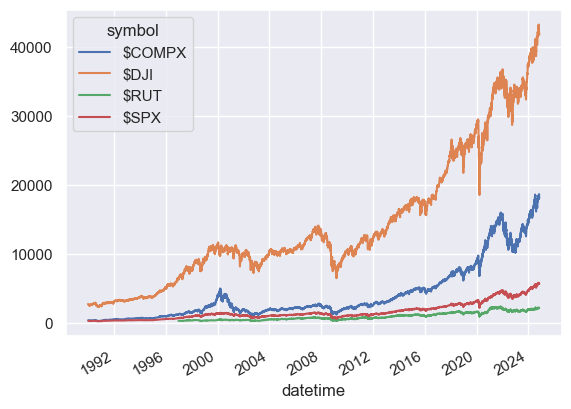

In [17]:
ph_close.plot()

In [32]:
spx = ph.query("symbol == '$SPX'")
seed = 1029384
rng = np.random.default_rng(seed)
initial_value = 1000
pct_changes = rng.normal(size=len(spx)) / 100

john_prices = (
    pd.DataFrame.from_dict(
        {
            'symbol': '$JOHN',
            'initial_value': initial_value,
            'pct_changes': pct_changes,
            'cum_pct_changes': np.cumprod(1 + pct_changes),
        }
    ).assign(close=lambda df: df.initial_value * df.cum_pct_changes)
    .set_index(spx.index)
)
john_prices

,symbol,initial_value,pct_changes,cum_pct_changes,close
datetime,,,,,
1971-01-04 06:00:00,$JOHN,1000,-0.006757,0.993243,993.243191
1971-01-05 06:00:00,$JOHN,1000,-0.011792,0.981531,981.530788
1971-01-06 06:00:00,$JOHN,1000,-0.014130,0.967662,967.662244
1971-01-07 06:00:00,$JOHN,1000,-0.001163,0.966537,966.537029
1971-01-08 06:00:00,$JOHN,1000,-0.007017,0.959755,959.754819
...,...,...,...,...,...
2024-10-28 05:00:00,$JOHN,1000,0.013063,7.809596,7809.595929
2024-10-29 05:00:00,$JOHN,1000,0.006874,7.863283,7863.282955
2024-10-30 05:00:00,$JOHN,1000,-0.000610,7.858488,7858.487844


<Axes: >

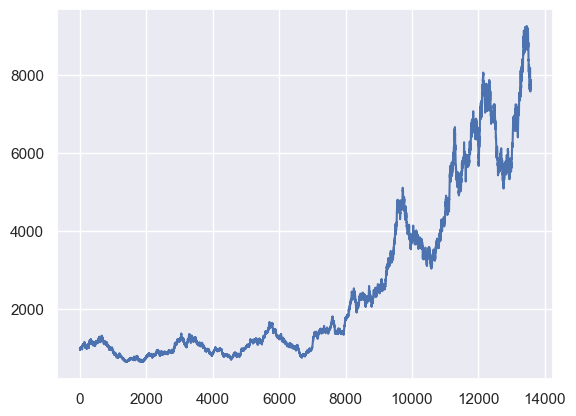

In [ ]:
john_prices.close.plot()

In [34]:
idx = ph.query('symbol == "$SPX"').index.get_level_values(0)

# john_mi = pd.MultiIndex.from_product([idx, ("$JOHN",)])

john_index = john_prices[['close', 'symbol']]

john_index
pd.concat([ph, john_index])

,open,high,low,close,volume,symbol,empty
datetime,,,,,,,
1971-01-04 06:00:00,92.15,92.19,90.64,91.150000,0.0,$SPX,False
1971-01-05 06:00:00,91.15,92.28,90.69,91.800000,0.0,$SPX,False
1971-01-06 06:00:00,91.80,93.00,91.50,92.350000,0.0,$SPX,False
1971-01-07 06:00:00,92.35,93.26,91.75,92.380000,0.0,$SPX,False
1971-01-08 06:00:00,92.38,93.02,91.60,92.190000,0.0,$SPX,False
...,...,...,...,...,...,...,...
2024-10-28 05:00:00,NaN,NaN,NaN,7809.595929,NaN,$JOHN,NaN
2024-10-29 05:00:00,NaN,NaN,NaN,7863.282955,NaN,$JOHN,NaN
2024-10-30 05:00:00,NaN,NaN,NaN,7858.487844,NaN,$JOHN,NaN


In [37]:
(
    pd.concat([ph, john_index])
    .to_csv('data/stock-index-price-history.csv')
)

# Exploring ph transformations

In [61]:
(
    ph[['close', 'symbol']].assign(
        max_close=ph.close.max(),
        min_close=ph.close.min(),
        max_close2=ph.groupby('symbol')[['close']].transform('max'),
        min_close2=ph.groupby('symbol')[['close']].transform('min'),
    )
)

,close,symbol,max_close,min_close,max_close2,min_close2
datetime,,,,,,
1971-01-04 06:00:00,91.1500,$SPX,43275.91,54.87,5864.670000,62.28
1971-01-05 06:00:00,91.8000,$SPX,43275.91,54.87,5864.670000,62.28
1971-01-06 06:00:00,92.3500,$SPX,43275.91,54.87,5864.670000,62.28
1971-01-07 06:00:00,92.3800,$SPX,43275.91,54.87,5864.670000,62.28
1971-01-08 06:00:00,92.1900,$SPX,43275.91,54.87,5864.670000,62.28
...,...,...,...,...,...,...
2024-10-28 05:00:00,2244.0683,$RUT,43275.91,54.87,2442.741702,310.28
2024-10-29 05:00:00,2238.0888,$RUT,43275.91,54.87,2442.741702,310.28
2024-10-30 05:00:00,2233.0362,$RUT,43275.91,54.87,2442.741702,310.28


Note that since the daily price tickers are only for trading days that you wouldn't want to use 5d here.
Easily just 5 rolling day.
Unless there's a business day version?

In [195]:
window = 5
# window = '5d'

(
    ph[['close', 'symbol']]
    .assign(
        rolling_mean_close=ph.groupby('symbol')[['close']].transform(lambda x: x.rolling(window).mean()),
        rolling_min_close=ph.groupby('symbol')[['close']].transform(lambda x: x.rolling(window).min()),
        rolling_max_close=ph.groupby('symbol')[['close']].transform(lambda x: x.rolling(window).max()),
        close_to_rolling_min=lambda df: df.close - df.rolling_min_close,
        close_to_rolling_max=lambda df: df.close - df.rolling_max_close,
    )
)

,close,symbol,rolling_mean_close,rolling_min_close,rolling_max_close,close_to_rolling_min,close_to_rolling_max
datetime,,,,,,,
1971-01-04 06:00:00,91.1500,$SPX,NaN,NaN,NaN,NaN,NaN
1971-01-05 06:00:00,91.8000,$SPX,NaN,NaN,NaN,NaN,NaN
1971-01-06 06:00:00,92.3500,$SPX,NaN,NaN,NaN,NaN,NaN
1971-01-07 06:00:00,92.3800,$SPX,NaN,NaN,NaN,NaN,NaN
1971-01-08 06:00:00,92.1900,$SPX,91.97400,91.1500,92.3800,1.0400,-0.1900
...,...,...,...,...,...,...,...
2024-10-28 05:00:00,2244.0683,$RUT,2223.27066,2207.9948,2244.0683,36.0735,0.0000
2024-10-29 05:00:00,2238.0888,$RUT,2224.58264,2207.9948,2244.0683,30.0940,-5.9795
2024-10-30 05:00:00,2233.0362,$RUT,2228.42210,2207.9948,2244.0683,25.0414,-11.0321


In [196]:
for i in ph.groupby('symbol').groups:
    print(i)

$COMPX
$DJI
$RUT
$SPX


In [197]:
for i in ph.groupby('symbol').rolling(window): print(i)

                      open   high    low  close  volume  empty
datetime                                                      
1971-02-05 06:00:00  100.0  100.0  100.0  100.0       0  False
                       open    high     low   close  volume  empty
datetime                                                          
1971-02-05 06:00:00  100.00  100.00  100.00  100.00       0  False
1971-02-08 06:00:00  100.84  100.84  100.84  100.84       0  False
                       open    high     low   close  volume  empty
datetime                                                          
1971-02-05 06:00:00  100.00  100.00  100.00  100.00       0  False
1971-02-08 06:00:00  100.84  100.84  100.84  100.84       0  False
1971-02-09 06:00:00  100.76  100.76  100.76  100.76       0  False
                       open    high     low   close  volume  empty
datetime                                                          
1971-02-05 06:00:00  100.00  100.00  100.00  100.00       0  False
1971-02

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



                          open     high        low    close      volume  empty
datetime                                                                      
2002-02-28 06:00:00  1759.3300  1773.20  1728.6500  1731.49  1934325500  False
2002-03-01 06:00:00  1745.4900  1802.89  1742.0800  1802.74  1904093800  False
2002-03-04 06:00:00  1799.6801  1859.72  1789.7200  1859.32 -1999378700  False
2002-03-05 06:00:00  1854.7100  1886.15  1849.7500  1866.29  2073528800  False
2002-03-06 06:00:00  1859.2800  1891.83  1841.3101  1890.40  1905743600  False
                          open     high        low    close      volume  empty
datetime                                                                      
2002-03-01 06:00:00  1745.4900  1802.89  1742.0800  1802.74  1904093800  False
2002-03-04 06:00:00  1799.6801  1859.72  1789.7200  1859.32 -1999378700  False
2002-03-05 06:00:00  1854.7100  1886.15  1849.7500  1866.29  2073528800  False
2002-03-06 06:00:00  1859.2800  1891.83  1841.3101  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



                          open       high        low      close  volume  empty
datetime                                                                      
1977-03-21 06:00:00  961.00000  961.40002  949.50000  953.53998       0  False
1977-03-22 06:00:00  953.50000  956.00000  944.70001  950.96002       0  False
1977-03-23 06:00:00  951.00000  954.40002  940.20001  942.32001       0  False
1977-03-24 06:00:00  942.29999  944.50000  931.90002  935.66998       0  False
1977-03-25 06:00:00  935.70001  937.50000  925.09998  928.85999       0  False
                          open       high        low      close  volume  empty
datetime                                                                      
1977-03-22 06:00:00  953.50000  956.00000  944.70001  950.96002       0  False
1977-03-23 06:00:00  951.00000  954.40002  940.20001  942.32001       0  False
1977-03-24 06:00:00  942.29999  944.50000  931.90002  935.66998       0  False
1977-03-25 06:00:00  935.70001  937.50000  925.09998

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



                           open        high         low       close   volume  \
datetime                                                                       
2006-08-21 05:00:00  11380.6699  11380.9902  11321.9902  11345.0498  1962200   
2006-08-22 05:00:00  11344.4102  11383.7100  11303.3398  11339.8398  2136900   
2006-08-23 05:00:00  11337.1201  11370.8203  11264.0400  11297.9004  1704100   
2006-08-24 05:00:00  11297.8203  11334.7197  11273.8896  11304.4600  1707100   
2006-08-25 05:00:00  11301.2197  11317.4297  11260.2803  11284.0498  1502000   

                     empty  
datetime                    
2006-08-21 05:00:00  False  
2006-08-22 05:00:00  False  
2006-08-23 05:00:00  False  
2006-08-24 05:00:00  False  
2006-08-25 05:00:00  False  
                           open        high         low       close   volume  \
datetime                                                                       
2006-08-22 05:00:00  11344.4102  11383.7100  11303.3398  11339.8398  2136900

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



                          open       high        low      close      volume  \
datetime                                                                      
2006-05-05 05:00:00  774.71997  784.62000  774.71997  781.83002   982675970   
2006-05-08 05:00:00  781.83002  782.78998  778.64001  781.59998   817329980   
2006-05-09 05:00:00  781.59998  782.47998  779.46002  780.71997   841572800   
2006-05-10 05:00:00  780.69000  780.69000  772.75000  775.94000   943258430   
2006-05-11 05:00:00  775.88000  775.88000  757.46002  757.46997  1079553540   

                     empty  
datetime                    
2006-05-05 05:00:00  False  
2006-05-08 05:00:00  False  
2006-05-09 05:00:00  False  
2006-05-10 05:00:00  False  
2006-05-11 05:00:00  False  
                          open       high        low      close      volume  \
datetime                                                                      
2006-05-08 05:00:00  781.83002  782.78998  778.64001  781.59998   817329980   
2006-0

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



                       open    high     low   close  volume  empty
datetime                                                          
1982-02-11 06:00:00  114.66  115.59  113.41  114.43       0  False
1982-02-12 06:00:00  114.43  115.39  113.70  114.38       0  False
1982-02-16 06:00:00  114.38  114.63  112.06  114.06       0  False
1982-02-17 06:00:00  114.06  115.09  112.97  113.69       0  False
1982-02-18 06:00:00  113.69  115.04  112.97  113.82       0  False
                       open    high     low   close  volume  empty
datetime                                                          
1982-02-12 06:00:00  114.43  115.39  113.70  114.38       0  False
1982-02-16 06:00:00  114.38  114.63  112.06  114.06       0  False
1982-02-17 06:00:00  114.06  115.09  112.97  113.69       0  False
1982-02-18 06:00:00  113.69  115.04  112.97  113.82       0  False
1982-02-19 06:00:00  113.82  114.58  112.33  113.22       0  False
                       open    high     low   close  volume  e

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



                        open     high      low    close  volume  empty
datetime                                                              
2011-05-31 05:00:00  1331.10  1345.20  1331.10  1345.20       0  False
2011-06-01 05:00:00  1345.20  1345.20  1313.71  1314.55       0  False
2011-06-02 05:00:00  1314.55  1318.03  1305.61  1312.94       0  False
2011-06-03 05:00:00  1312.94  1312.94  1297.90  1300.16       0  False
2011-06-06 05:00:00  1300.26  1300.26  1284.72  1286.17       0  False
                        open     high      low    close  volume  empty
datetime                                                              
2011-06-01 05:00:00  1345.20  1345.20  1313.71  1314.55       0  False
2011-06-02 05:00:00  1314.55  1318.03  1305.61  1312.94       0  False
2011-06-03 05:00:00  1312.94  1312.94  1297.90  1300.16       0  False
2011-06-06 05:00:00  1300.26  1300.26  1284.72  1286.17       0  False
2011-06-07 05:00:00  1286.31  1296.22  1284.74  1284.94       0  False
      

In [303]:
from functools import partial


# Could this work well as a pandas extension? Instead of using partial functions.
def window_agg(df, func, column='close', partition_by=None):
    if partition_by is None:
        return df.loc[:, column].agg(func)
    else:
        return df.groupby(partition_by)[[column]].transform(func)

ph.assign(
    min_close=partial(window_agg, func='min', partition_by='symbol'),
    sum_close=partial(window_agg, func='sum'),
    max_close=partial(window_agg, func='max'),
    count_close=partial(window_agg, func='count'),
    # max_close=partial(agg_close, agg_function='min'),
)

# None is None
# ph[['close']].agg('min')

# partial(agg_close, agg_function='min')
# partial?
# ph[['close']].assign(min_close=min_close)

,open,high,low,close,volume,symbol,empty,min_close,sum_close,max_close,count_close
datetime,,,,,,,,,,,
1971-01-04 06:00:00,92.1500,92.1900,90.6400,91.1500,0,$SPX,False,62.28,1.900385e+08,43275.91,47712
1971-01-05 06:00:00,91.1500,92.2800,90.6900,91.8000,0,$SPX,False,62.28,1.900385e+08,43275.91,47712
1971-01-06 06:00:00,91.8000,93.0000,91.5000,92.3500,0,$SPX,False,62.28,1.900385e+08,43275.91,47712
1971-01-07 06:00:00,92.3500,93.2600,91.7500,92.3800,0,$SPX,False,62.28,1.900385e+08,43275.91,47712
1971-01-08 06:00:00,92.3800,93.0200,91.6000,92.1900,0,$SPX,False,62.28,1.900385e+08,43275.91,47712
...,...,...,...,...,...,...,...,...,...,...,...
2024-10-28 05:00:00,2217.6655,2247.3814,2217.6655,2244.0683,0,$RUT,False,310.28,1.900385e+08,43275.91,47712
2024-10-29 05:00:00,2236.5139,2238.0909,2221.7490,2238.0888,0,$RUT,False,310.28,1.900385e+08,43275.91,47712
2024-10-30 05:00:00,2232.6573,2260.4769,2229.7862,2233.0362,0,$RUT,False,310.28,1.900385e+08,43275.91,47712
